In [14]:
import dill # for saving notebook session
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torchvision import transforms
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [87]:
dill.dump_session('notebook_env.db')

In [3]:
dill.load_session('notebook_env.db')

In [ ]:
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")
device

In [91]:
torch.save(D.state_dict(), 'Discriminator')
torch.save(G.state_dict(), 'Generator')

In [89]:
G = Generator().to(device)
D = Discriminator().to(device)
G.load_state_dict(torch.load('Generator'))
D.load_state_dict(torch.load('Discriminator'))

Discriminator(
  (layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): LeakyReLU(negative_slope=0.2, inplace=True)
    (7): Conv2d(256, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
    (10): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (11): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): LeakyReLU(negative_slope=0

In [6]:
b_size = 16
lr_G = 0.0002
lr_D = 0.00005
beta1 = 0.5
noise_size = 1000

In [37]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.layers = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(noise_size, 1024, 4, 1, 0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( 1024, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( 512, 258, 4, 2, 1, bias=False),
            nn.BatchNorm2d(258),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 32 x 32``
            nn.ConvTranspose2d( 258, 124, 4, 2, 1, bias=False),
            nn.BatchNorm2d(124),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 64 x 64``
            nn.ConvTranspose2d( 124, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            
            # state size. ``(ngf) x 128 x 128``
            nn.ConvTranspose2d( 64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 128 x 128``
        )
        
        self.apply(_weights_init)
        
    def forward(self, x):
        x = self.layers(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.layers = nn.Sequential(
            # input is ``(nc) x 128 x 128``
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(256, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.layers(input)                   

                      
def _weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [38]:

dataset = ImageFolder(root='images', transform=transforms.Compose([
    transforms.Resize((128,128)),
    transforms.CenterCrop((128,128)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.5, 0.5, 0.5],
        std=[0.5, 0.5, 0.5]
    )
]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=b_size,
                                         shuffle=True, num_workers=1)

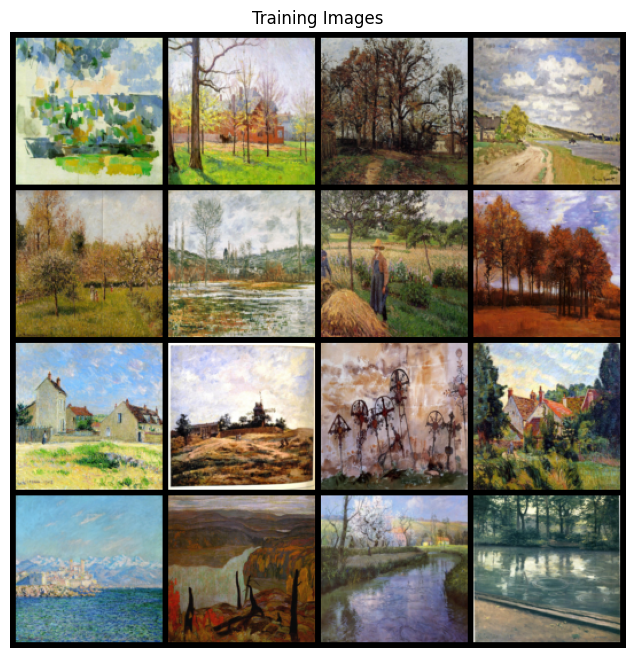

In [44]:
batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(batch[0].to(device)[:b_size], nrow = int(np.sqrt(b_size)), padding=5, normalize=True).cpu(),(1,2,0)))

In [45]:
G = Generator().to(device)
print(G)

Generator(
  (layers): Sequential(
    (0): ConvTranspose2d(1000, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 258, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(258, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(258, 124, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(124, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(124, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Bat

In [46]:
D = Discriminator().to(device)
print(D)

Discriminator(
  (layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): LeakyReLU(negative_slope=0.2, inplace=True)
    (7): Conv2d(256, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
    (10): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (11): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): LeakyReLU(negative_slope=0

In [47]:
optimizerD = optim.Adam(D.parameters(), lr=lr_D, betas=(beta1, 0.999))
optimizerG = optim.Adam(G.parameters(), lr=lr_G, betas=(beta1, 0.999))
real_label = 1.
fake_label = 0.
fixed_noise = torch.randn(64, noise_size, 1, 1, device = device)
criterion = nn.BCELoss()
img_list = []
G_losses = []
D_losses = []
iters = 0

In [55]:
num_epochs = 500

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        D.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device = device)
        # Forward pass real batch through D
        output = D(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, noise_size, 1, 1, device = device)
        # Generate fake image batch with G
        fake = G(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = D(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        G.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = D(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = G(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/500][0/332]	Loss_D: 0.8230	Loss_G: 1.7120	D(x): 0.6753	D(G(z)): 0.3241 / 0.2022
[0/500][50/332]	Loss_D: 1.3554	Loss_G: 1.4733	D(x): 0.4432	D(G(z)): 0.3552 / 0.2520
[0/500][100/332]	Loss_D: 0.8044	Loss_G: 1.9351	D(x): 0.8432	D(G(z)): 0.4374 / 0.1644
[0/500][150/332]	Loss_D: 0.9712	Loss_G: 2.0544	D(x): 0.6717	D(G(z)): 0.3981 / 0.1447
[0/500][200/332]	Loss_D: 1.3672	Loss_G: 1.1752	D(x): 0.4517	D(G(z)): 0.3874 / 0.3271
[0/500][250/332]	Loss_D: 1.1841	Loss_G: 1.6420	D(x): 0.6841	D(G(z)): 0.5113 / 0.2096
[0/500][300/332]	Loss_D: 1.2598	Loss_G: 1.5175	D(x): 0.6838	D(G(z)): 0.5322 / 0.2418
[1/500][0/332]	Loss_D: 1.0482	Loss_G: 1.8204	D(x): 0.7672	D(G(z)): 0.5156 / 0.1757
[1/500][50/332]	Loss_D: 1.1238	Loss_G: 1.5398	D(x): 0.5233	D(G(z)): 0.3344 / 0.2437
[1/500][100/332]	Loss_D: 1.0184	Loss_G: 1.7952	D(x): 0.5425	D(G(z)): 0.3000 / 0.1773
[1/500][150/332]	Loss_D: 0.8089	Loss_G: 1.8221	D(x): 0.7284	D(G(z)): 0.3633 / 0.1775
[1/500][200/332]	Loss_D: 1.3390	Loss_G: 1.540

KeyboardInterrupt: 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


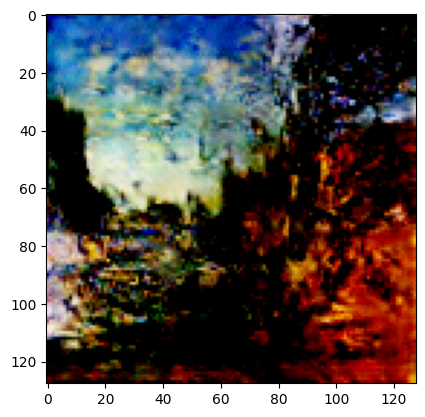

In [88]:
noise = torch.randn(1, noise_size, 1, 1, device=device)
fake = G.forward(noise)
fake_im = fake[0].detach()
plt.imshow(np.transpose(fake_im.cpu(),(1,2,0)))

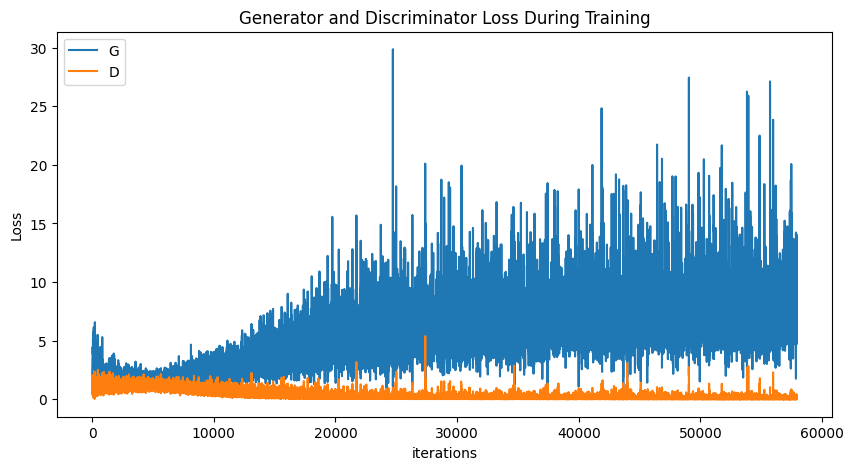

In [57]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

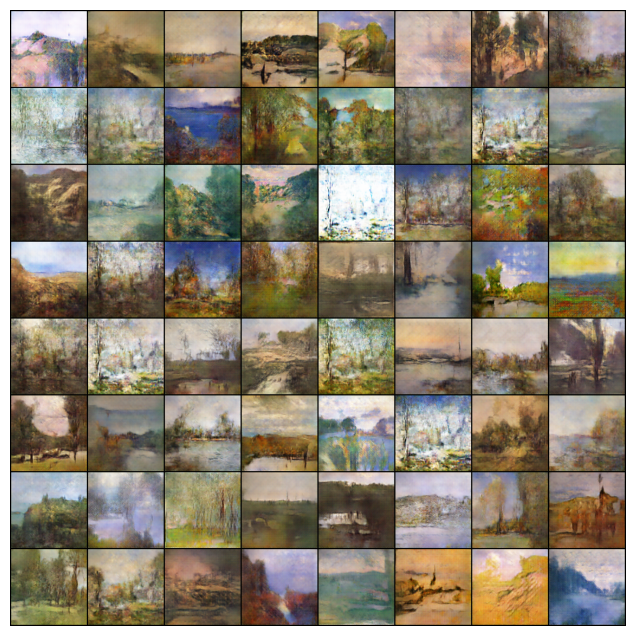

In [15]:
start = 0
end = 100
every_n = 5

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[start:end:every_n]]
matplotlib.rcParams['animation.embed_limit'] = 2**256
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [16]:
f = "training-images.gif" 
writergif = animation.PillowWriter(fps=2) 
ani.save(f, writer=writergif)

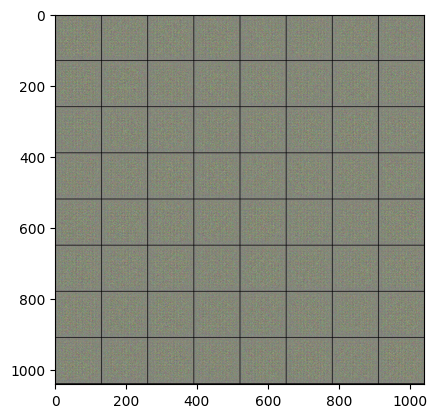

In [69]:
plt.imshow(np.transpose(img_list[0],(1,2,0)), animated=True)

In [11]:
len(img_list)

117